In [2]:
import os
import sys
import numpy as np
from scipy import signal
# import pickle
import time
import neuron
from neuron import h
from neuron import gui
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib import colors
import plotly
import random
import math
import matplotlib.colors as mcolors
import matplotlib.cm as cm
plt.rcParams.update({'font.size': 15})

--No graphics will be displayed.


In [12]:
!nrnivmodl /home/mjy/project/bilinear_network/2021Neuron/L5PC/mods

/home/mjy/project/bilinear_network/2021Neuron/L5PC
cfiles =
Mod files: "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/CaDynamics_E2.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/Ca_HVA.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/Ca_LVAst.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/epsp.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/Ih.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/Im.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/K_Pst.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/K_Tst.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/kv.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/na.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/Nap_Et2.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/NaTa_t.mod" "/home/mjy/project/bilinear_network/2021Neuron/L5PC/mods/NaTs2_t.mod" "/home/mjy/project/bilinear_network/2021N

In [3]:
# h.load_file('nrngui.hoc')
h.load_file("import3d.hoc")

morphologyFilename = "morphologies/cell1.asc"
biophysicalModelFilename = "L5PCbiophys5b.hoc"
biophysicalModelTemplateFilename = "L5PCtemplate_2.hoc"

h.load_file(biophysicalModelFilename)
h.load_file(biophysicalModelTemplateFilename)
L5PC = h.L5PCtemplate(morphologyFilename)

845.34678 
845.34678 


In [4]:
h.topology()


|-|       L5PCtemplate[0].soma[0](0-1)
  `|       L5PCtemplate[0].dend[0](0-1)
    `|       L5PCtemplate[0].dend[1](0-1)
      `------|       L5PCtemplate[0].dend[2](0-1)
      `|       L5PCtemplate[0].dend[3](0-1)
        `----|       L5PCtemplate[0].dend[4](0-1)
        `--------|       L5PCtemplate[0].dend[5](0-1)
    `------|       L5PCtemplate[0].dend[6](0-1)
  `|       L5PCtemplate[0].dend[7](0-1)
    `|       L5PCtemplate[0].dend[8](0-1)
      `|       L5PCtemplate[0].dend[9](0-1)
      `--|       L5PCtemplate[0].dend[10](0-1)
    `|       L5PCtemplate[0].dend[11](0-1)
      `|       L5PCtemplate[0].dend[12](0-1)
        `------|       L5PCtemplate[0].dend[13](0-1)
        `------|       L5PCtemplate[0].dend[14](0-1)
      `--|       L5PCtemplate[0].dend[15](0-1)
  `|       L5PCtemplate[0].dend[16](0-1)
    `|       L5PCtemplate[0].dend[17](0-1)
      `|       L5PCtemplate[0].dend[18](0-1)
        `|       L5PCtemplate[0].dend[19](0-1)
        `|       L5PCtemplate[0].dend[20](

1.0

In [9]:
segment1 = L5PC.apic[78]
segment2 = L5PC.soma[0]

# Set the coordinates of the segments
x1, y1, z1 = segment1.x3d(0), segment1.y3d(0), segment1.z3d(0)
x2, y2, z2 = segment2.x3d(0), segment2.y3d(0), segment2.z3d(0)

# Calculate Euclidean distance between the two points
distance = math.sqrt((x2 - x1)**2 + (y2 - y1)**2 + (z2 - z1)**2)

# Print the distance
print("Distance between segments:", distance)

Distance between segments: 979.5423667870152


In [5]:
neuron.distance(L5PC.apic[78](0.5), L5PC.soma(0.5))

AttributeError: module 'neuron' has no attribute 'distance'

In [27]:
len(cell_coordinates)

4268

number of synapses: 0
number of synapses: 0


/tmp/ipykernel_3145861/3639716077.py:300: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, shrink=0.6)


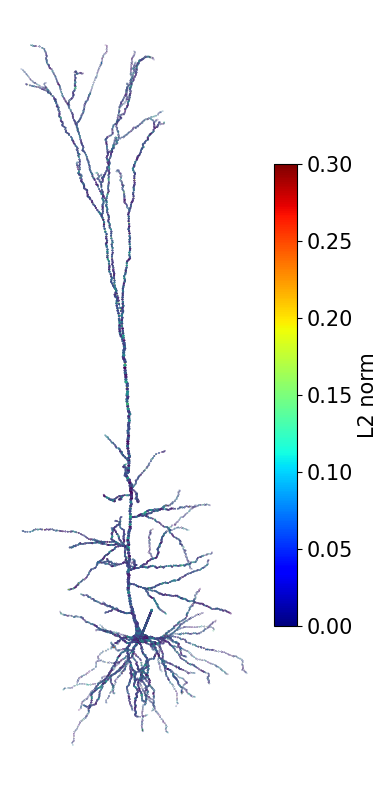

In [32]:
cmap = cm.get_cmap("viridis")



nsyn = 00
cell_secs = []
for sec in h.allsec(): 
    cell_secs.append(sec)
    sec.nseg = 100

locs = np.empty((100, 2))
for i in range(len(locs)):
    locs[i, 0] = int(np.random.randint(83))
    locs[i, 1] = np.random.random()
# Add dummy compartments at synapse locations
synapses = []
print ('number of synapses:', nsyn)
for s in np.arange(0,nsyn):
    synapses.append(h.Section())
    synapses[s].L = 5# 1e-6
    synapses[s].diam = 1#1e-6
    idend = int(locs[s,0])
    if (idend > -1):
        synapses[s].connect(L5PC.dend[idend], int(locs[s,1]), 0)
    else :
        synapses[s].connect(L5PC.soma, 0.5, 0)
#----------------------------------------------------------------------------
# Get numbers for plotting cell morphology
# cell: [xstart xend ystart yend diamstart diamend]
# synapse: [x, y]
h.define_shape()
cell_coordinates = []
for sec in cell_secs:
    sec.push()
    for stepCount in np.arange(1, h.n3d()):
        stepCount =  float(stepCount)
        cell_coordinates.append([h.x3d(stepCount-1), h.x3d(stepCount),
                                h.y3d(stepCount-1), h.y3d(stepCount),
                                    h.diam3d(stepCount-1), h.diam3d(stepCount)])
    h.pop_section()

set_dends = set(locs[:,0])

# I don't know how to work with sets, so convert it to an array
set_dends = np.array(list(set_dends))
dend_coord = []
for i_dend in np.arange(0,len(set_dends)):
    syn_coordinates = []
    d_dend = int(set_dends[i_dend])
    if (d_dend > -1):
        L5PC.dend[d_dend].push()
    else :
        L5PC.soma.push()
    for stepCount in np.arange(1, h.n3d()):
        stepCount =  float(stepCount)
        syn_coordinates.append([h.x3d(stepCount-1), h.x3d(stepCount),
                                h.y3d(stepCount-1), h.y3d(stepCount), 
                                h.diam3d(stepCount-1), h.diam3d(stepCount)])
    h.pop_section()
    dend_coord.append(syn_coordinates)
#----------------------------------------------------------------------------
# Make plot
plt.figure(figsize=(4, 10))

# Cell
for pt in np.arange(len(cell_coordinates)):
    random_value = random.betavariate(alpha=2, beta=5)/4  # Replace this with your data

    norm = mcolors.Normalize(vmin=0, vmax=0.3)
    normalized_value = norm(random_value)
    
    # Get the color from the colormap based on the normalized value
    section_color = cmap(normalized_value)

    xstart, xend = cell_coordinates[pt][0], cell_coordinates[pt][1]
    ystart, yend = cell_coordinates[pt][2], cell_coordinates[pt][3]
    lx = xend-xstart
    ly = yend-ystart
    l = np.sqrt(np.dot([lx,ly],[lx,ly]))
    diamstart = cell_coordinates[pt][4] / 2
    diamend = cell_coordinates[pt][5] / 2

    if diamstart > 8: diamstart=diamstart/3.5
    if diamend > 8: diamend=diamend/3.5

    if l>0:
        plt.fill([xstart+2*diamstart*ly/(2*l), xend+2*diamend*ly/(2*l),
                    xend-2*diamend*ly/(2*l), xstart-2*diamstart*ly/(2*l)], 
                    [ystart-2*diamstart*lx/(2*l), yend-2*diamend*lx/(2*l),
                    yend+2*diamend*lx/(2*l), ystart+2*diamstart*lx/(2*l)],
                    section_color, lw=0) 

    c1 = plt.Circle((xstart, ystart), diamstart, color=section_color, lw=1)
    c2 = plt.Circle((xend, yend), diamend, color=section_color, lw=1) 
    plt.gca().add_patch(c1)
    plt.gca().add_patch(c2)
    
# Synapses
# nsyn_d = data.Ensyn
nsyn_d = [100]
#if (plotInh): nsyn_d = nsyn_d + [sum(data.Insyn)] # all inhibitory synapses are plotted with the same color 


idsyn = nsyn_d[:]
for ii in np.arange(len(idsyn)):
    idsyn[ii] = sum(nsyn_d[0:(ii+1)])

ecols13 = ['#6d4022', '#a05e32',
            '#512100', '#883600', '#b44800', '#e35b00', '#ff802b',
            '#715b00', '#ac8a00', '#d4aa00', '#f9c800',
            '#6d6649', '#a89f7d']     
ecols4 = ['#6d4022', '#b44800', '#d4aa00', '#a89f7d']     
ecols1 = ['#a05e32']
     
# if (len(data.Ensyn)==13):
#         ecols = ecols13
# elif (len(data.Ensyn)==4):
#         ecols = ecols4
# elif (len(data.Ensyn)==1):
#         ecols = ecols1

ecols = ['#a05e32']

#else : # a colormap with random colors for each cluster
cmap = cm.get_cmap(name="jet")
# nden = len(data.Ensyn)
nden = len(nsyn_d)
ecols = [None] * nden
np.random.seed(seed=16)
for icol in np.arange(nden):
    icc = np.random.randint(256)
    ecols[icol] = colors.rgb2hex(cmap(icc))
icols = ['#000000']
# print (ecols)
# print (idsyn)
for syn in np.arange(nsyn):
    # select the branch for the synapse
    idend = int(locs[syn,0])
    iidend = int(np.argwhere(set_dends == idend))
    syn_coordinates = dend_coord[iidend]
    ptmax=np.shape(syn_coordinates)[0]
    # find the coordinates along the branch
    ptt = locs[syn,1] * ptmax
    pt = int(np.floor(ptt))
    ptd = ptt - pt
    xstart, xend = syn_coordinates[pt][0], syn_coordinates[pt][1]
    ystart, yend = syn_coordinates[pt][2], syn_coordinates[pt][3]
    lx = xend-xstart
    ly = yend-ystart
    x = xstart + lx * ptd
    y = ystart + lx * ptd
    # nEsyn = sum(data.Ensyn)
    nEsyn = 600
    if (syn < nEsyn):
        iden = -1
        for ii in np.arange(len(idsyn)):
                if syn >= idsyn[ii]: iden = ii
        iden = iden + 1
        # print (syn, iden)
        colsyn = ecols[iden]
        # c = plt.Circle((x,y), 3, color=colsyn, lw=0)
        c = plt.Circle((x,y), 5, color='red', lw=0)
    else :
        # c = plt.Circle((x,y), 3, color=icols[0], lw=2)
        c = plt.Circle((x,y), 5, color='red', lw=2)
    plt.gca().add_patch(c)
#-----------------------------------------

# add synapses on the apic

#-----------------------------------------
nsyn = 00
cell_secs = []
for sec in h.allsec(): 
    cell_secs.append(sec)
    sec.nseg = 600

locs = np.empty((600, 2))
for i in range(len(locs)):
    locs[i, 0] = int(np.random.randint(108))
    locs[i, 1] = np.random.random()
# Add dummy compartments at synapse locations
synapses = []
print ('number of synapses:', nsyn)
for s in np.arange(0,nsyn):
    synapses.append(h.Section())
    synapses[s].L = 5# 1e-6
    synapses[s].diam = 1#1e-6
    idend = int(locs[s,0])
    if (idend > -1):
        synapses[s].connect(L5PC.apic[idend], int(locs[s,1]), 0)
    else :
        synapses[s].connect(L5PC.soma, 0.5, 0)
#----------------------------------------------------------------------------
# Get numbers for plotting cell morphology
# cell: [xstart xend ystart yend diamstart diamend]
# synapse: [x, y]
h.define_shape()
cell_coordinates = []
for sec in cell_secs:
    sec.push()
    for stepCount in np.arange(1, h.n3d()):
        stepCount =  float(stepCount)
        cell_coordinates.append([h.x3d(stepCount-1), h.x3d(stepCount),
                                h.y3d(stepCount-1), h.y3d(stepCount),
                                    h.diam3d(stepCount-1), h.diam3d(stepCount)])
    h.pop_section()

set_dends = set(locs[:,0])

# I don't know how to work with sets, so convert it to an array
set_dends = np.array(list(set_dends))
dend_coord = []
for i_dend in np.arange(0,len(set_dends)):
    syn_coordinates = []
    d_dend = int(set_dends[i_dend])
    if (d_dend > -1):
        L5PC.apic[d_dend].push()
    else :
        L5PC.soma.push()
    for stepCount in np.arange(1, h.n3d()):
        stepCount =  float(stepCount)
        syn_coordinates.append([h.x3d(stepCount-1), h.x3d(stepCount),
                                h.y3d(stepCount-1), h.y3d(stepCount), 
                                h.diam3d(stepCount-1), h.diam3d(stepCount)])
    h.pop_section()
    dend_coord.append(syn_coordinates)
    
# Synapses
# nsyn_d = data.Ensyn
nsyn_d = [0]
#if (plotInh): nsyn_d = nsyn_d + [sum(data.Insyn)] # all inhibitory synapses are plotted with the same color 


idsyn = nsyn_d[:]
for ii in np.arange(len(idsyn)):
    idsyn[ii] = sum(nsyn_d[0:(ii+1)])

ecols13 = ['#6d4022', '#a05e32',
            '#512100', '#883600', '#b44800', '#e35b00', '#ff802b',
            '#715b00', '#ac8a00', '#d4aa00', '#f9c800',
            '#6d6649', '#a89f7d']     
ecols4 = ['#6d4022', '#b44800', '#d4aa00', '#a89f7d']     
ecols1 = ['#a05e32']
     
# if (len(data.Ensyn)==13):
#         ecols = ecols13
# elif (len(data.Ensyn)==4):
#         ecols = ecols4
# elif (len(data.Ensyn)==1):
#         ecols = ecols1

ecols = ['#a05e32']

#else : # a colormap with random colors for each cluster
cmap = cm.get_cmap(name="jet")
# nden = len(data.Ensyn)
nden = len(nsyn_d)
ecols = [None] * nden
np.random.seed(seed=16)
for icol in np.arange(nden):
    icc = np.random.randint(256)
    ecols[icol] = colors.rgb2hex(cmap(icc))
icols = ['#000000']
# print (ecols)
# print (idsyn)
for syn in np.arange(nsyn):
    # select the branch for the synapse
    idend = int(locs[syn,0])
    iidend = int(np.argwhere(set_dends == idend))
    syn_coordinates = dend_coord[iidend]
    ptmax=np.shape(syn_coordinates)[0]
    # find the coordinates along the branch
    ptt = locs[syn,1] * ptmax
    pt = int(np.floor(ptt))
    ptd = ptt - pt
    xstart, xend = syn_coordinates[pt][0], syn_coordinates[pt][1]
    ystart, yend = syn_coordinates[pt][2], syn_coordinates[pt][3]
    lx = xend-xstart
    ly = yend-ystart
    x = xstart + lx * ptd
    y = ystart + lx * ptd
    # nEsyn = sum(data.Ensyn)
    nEsyn = 600
    if (syn < nEsyn):
        iden = -1
        for ii in np.arange(len(idsyn)):
                if syn >= idsyn[ii]: iden = ii
        iden = iden + 1
        # print (syn, iden)
        colsyn = ecols[iden]
        # c = plt.Circle((x,y), 3, color=colsyn, lw=0)
        c = plt.Circle((x,y), 5, color='red', lw=0)
    else :
        # c = plt.Circle((x,y), 3, color=icols[0], lw=2)
        c = plt.Circle((x,y), 5, color='red', lw=2)
    plt.gca().add_patch(c)      
sm = cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Set an empty array or your data array
cbar = plt.colorbar(sm, shrink=0.6)
cbar.set_label('L2 norm')  # Add label to the colorbar
plt.axis('off')
# plt.xlim(-200,200)
# plt.ylim(-160,240)
plt.savefig('figure/L2_norm_on_dendrite.png', bbox_inches='tight', dpi=800)
plt.show()


# clustered

In [5]:
# add synapses on the apic

#-----------------------------------------
nsyn = 600
cell_secs = []
for sec in h.allsec(): 
    cell_secs.append(sec)
    sec.nseg = 100

locs = np.empty((600, 2))
for i in range(len(locs)):
    locs[i, 0] = int(np.random.randint(37, 70))
    locs[i, 1] = np.random.random()
# Add dummy compartments at synapse locations
synapses = []
print ('number of synapses:', nsyn)
for s in np.arange(0,nsyn):
    synapses.append(h.Section())
    synapses[s].L = 5# 1e-6
    synapses[s].diam = 1#1e-6
    idend = int(locs[s,0])
    if (idend > -1):
        synapses[s].connect(L5PC.apic[idend], int(locs[s,1]), 0)
    else :
        synapses[s].connect(L5PC.soma, 0.5, 0)
#----------------------------------------------------------------------------
# Get numbers for plotting cell morphology
# cell: [xstart xend ystart yend diamstart diamend]
# synapse: [x, y]
h.define_shape()
cell_coordinates = []
for sec in cell_secs:
    sec.push()
    for stepCount in np.arange(1, h.n3d()):
        stepCount =  float(stepCount)
        cell_coordinates.append([h.x3d(stepCount-1), h.x3d(stepCount),
                                h.y3d(stepCount-1), h.y3d(stepCount),
                                    h.diam3d(stepCount-1), h.diam3d(stepCount)])
    h.pop_section()

set_dends = set(locs[:,0])

# I don't know how to work with sets, so convert it to an array
set_dends = np.array(list(set_dends))
dend_coord = []
for i_dend in np.arange(0,len(set_dends)):
    syn_coordinates = []
    d_dend = int(set_dends[i_dend])
    if (d_dend > -1):
        L5PC.apic[d_dend].push()
    else :
        L5PC.soma.push()
    for stepCount in np.arange(1, h.n3d()):
        stepCount =  float(stepCount)
        syn_coordinates.append([h.x3d(stepCount-1), h.x3d(stepCount),
                                h.y3d(stepCount-1), h.y3d(stepCount), 
                                h.diam3d(stepCount-1), h.diam3d(stepCount)])
    h.pop_section()
    dend_coord.append(syn_coordinates)

#----------------------------------------------------------------------------
# Make plot
plt.figure(figsize=(4, 10))
# Cell
for pt in np.arange(len(cell_coordinates)):
    xstart, xend = cell_coordinates[pt][0], cell_coordinates[pt][1]
    ystart, yend = cell_coordinates[pt][2], cell_coordinates[pt][3]
    lx = xend-xstart
    ly = yend-ystart
    l = np.sqrt(np.dot([lx,ly],[lx,ly]))
    diamstart = cell_coordinates[pt][4] / 2
    diamend = cell_coordinates[pt][5] / 2

    if diamstart > 8: diamstart=diamstart/3.5
    if diamend > 8: diamend=diamend/3.5

    if l>0:
        plt.fill([xstart+2*diamstart*ly/(2*l), xend+2*diamend*ly/(2*l),
                    xend-2*diamend*ly/(2*l), xstart-2*diamstart*ly/(2*l)], 
                    [ystart-2*diamstart*lx/(2*l), yend-2*diamend*lx/(2*l),
                    yend+2*diamend*lx/(2*l), ystart+2*diamstart*lx/(2*l)],
                    'k', lw=0) 

    c1 = plt.Circle((xstart, ystart), diamstart, color='k', lw=0)
    c2 = plt.Circle((xend, yend), diamend, color='k', lw=0) 
    plt.gca().add_patch(c1)
    plt.gca().add_patch(c2)
        
# Synapses
# nsyn_d = data.Ensyn
nsyn_d = [600]
#if (plotInh): nsyn_d = nsyn_d + [sum(data.Insyn)] # all inhibitory synapses are plotted with the same color 


idsyn = nsyn_d[:]
for ii in np.arange(len(idsyn)):
    idsyn[ii] = sum(nsyn_d[0:(ii+1)])

ecols13 = ['#6d4022', '#a05e32',
            '#512100', '#883600', '#b44800', '#e35b00', '#ff802b',
            '#715b00', '#ac8a00', '#d4aa00', '#f9c800',
            '#6d6649', '#a89f7d']     
ecols4 = ['#6d4022', '#b44800', '#d4aa00', '#a89f7d']     
ecols1 = ['#a05e32']
     
# if (len(data.Ensyn)==13):
#         ecols = ecols13
# elif (len(data.Ensyn)==4):
#         ecols = ecols4
# elif (len(data.Ensyn)==1):
#         ecols = ecols1

ecols = ['#a05e32']

#else : # a colormap with random colors for each cluster
cmap = cm.get_cmap(name="jet")
# nden = len(data.Ensyn)
nden = len(nsyn_d)
ecols = [None] * nden
np.random.seed(seed=16)
for icol in np.arange(nden):
    icc = np.random.randint(256)
    ecols[icol] = colors.rgb2hex(cmap(icc))
icols = ['#000000']
# print (ecols)
# print (idsyn)
for syn in np.arange(nsyn):
    # select the branch for the synapse
    idend = int(locs[syn,0])
    iidend = int(np.argwhere(set_dends == idend))
    syn_coordinates = dend_coord[iidend]
    ptmax=np.shape(syn_coordinates)[0]
    # find the coordinates along the branch
    ptt = locs[syn,1] * ptmax
    pt = int(np.floor(ptt))
    ptd = ptt - pt
    xstart, xend = syn_coordinates[pt][0], syn_coordinates[pt][1]
    ystart, yend = syn_coordinates[pt][2], syn_coordinates[pt][3]
    lx = xend-xstart
    ly = yend-ystart
    x = xstart + lx * ptd
    y = ystart + lx * ptd
    # nEsyn = sum(data.Ensyn)
    nEsyn = 600
    if (syn < nEsyn):
        iden = -1
        for ii in np.arange(len(idsyn)):
                if syn >= idsyn[ii]: iden = ii
        iden = iden + 1
        # print (syn, iden)
        colsyn = ecols[iden]
        # c = plt.Circle((x,y), 3, color=colsyn, lw=0)
        if idend < 50:
            c = plt.Circle((x,y), 5, color='red', lw=0)
        elif idend < 63:
            c = plt.Circle((x,y), 5, color='green', lw=0)
        else:
            c = plt.Circle((x,y), 5, color='blue', lw=0)
    else :
        # c = plt.Circle((x,y), 3, color=icols[0], lw=2)
        c = plt.Circle((x,y), 5, color='black', lw=2)
    plt.gca().add_patch(c)      

# plt.axis('equal')
# plt.xlim(-200,200)
# plt.ylim(-160,240)
plt.show()

number of synapses: 600


In [76]:
ps = h.PlotShape(True)
ps.plot(plotly).show()